# The Beating Heart of Art

VGG16 + Nearest Neighbors

In [121]:
# for loading/processing the images  
from tensorflow.keras.preprocessing.image import load_img 
from tensorflow.keras.preprocessing.image import img_to_array 
from tensorflow.keras.applications.vgg16 import preprocess_input 
# models 
from tensorflow.keras.applications.vgg16 import VGG16 
from tensorflow.keras.models import Model
# neighbors and dimension reduction
from sklearn.neighbors import NearestNeighbors
from sklearn.decomposition import PCA
# for everything else
import os
import numpy as np
import matplotlib.pyplot as plt
from random import randint
import pandas as pd
import pickle

In [2]:
os.chdir('/Users/eric/code/Goli-SF/notebooks') # path where the "data" folder is located
!pwd

/Users/eric/code/Goli-SF/notebooks


In [3]:
def image_files(path):
    '''
    
    Creates a list with the names of all image files in the data folder.
    path: the path to the directory where the images are stored.
    
    '''
    image_files = []
    # creates a ScandirIterator aliased as files
    with os.scandir(path) as files:
      # loops through each file in the directory
        for file in files:
            if file.name.endswith('.jpg'):
              # adds only the image files to the flowers list
                image_files.append(f'{path}/{file.name}')
    return image_files

In [4]:
image_files = image_files('data/images_for_mode_test')

In [9]:
model = VGG16()
model = Model(inputs = model.inputs, outputs = model.layers[-2].output)

In [8]:
def extract_features(file, model):
    '''
    Extract features of an image file using the VGG16 model.
    '''
    # load the image as a 224x224 array
    img = load_img(file, target_size=(224,224))
    # convert from 'PIL.Image.Image' to numpy array
    img = np.array(img) 
    # reshape the data for the model reshape(num_of_samples, dim 1, dim 2, channels)
    reshaped_img = img.reshape(1,224,224,3) 
    # prepare image for model
    imgx = preprocess_input(reshaped_img)
    # get the feature vector
    features = model.predict(imgx, use_multiprocessing=True)

    return features

In [10]:
def all_features(image_files, model):
    data = {}
    for image in image_files:
    # try to extract the features and update the dictionary
        feat = extract_features(image, model)
        image = image.split('/')[-1]
        data[image] = feat
    return data

In [11]:
data = all_features(image_files, model)

1/1 [==============================] - 0s 418ms/step


In [57]:
# get a list of the filenames
filenames = np.array(list(data.keys()))

# get a list of just the features
feat = np.array(list(data.values()))

# reshape so that there are 210 samples of 4096 vectors
feat = feat.reshape(-1,4096)

In [61]:
pca = PCA(n_components=100, random_state=22)
pca.fit(feat)
X = pca.transform(feat)

In [98]:
def find_neighbors(X, target, n_neighbors=4):
    neigh = NearestNeighbors(n_neighbors=n_neighbors)
    neigh.fit(X)
    kneighbors = neigh.kneighbors(target.reshape(1,-1))[1].tolist()[0]
    return kneighbors

In [111]:
def plot_neighbors(neighbors):
    plt.figure(figsize = (50,50));
    for index, file in enumerate(neighbors):
        plt.subplot(1,len(neighbors),index+1);
        img = load_img(f'data/images_for_mode_test/{filenames[file]}')
        img = np.array(img)
        plt.imshow(img)
        plt.axis('off')
        if index == 0:
            plt.title('Input image', {'fontsize': 50, 'color': 'red'})

[0, 49, 44, 27]
[1, 49, 81, 55]
[2, 55, 94, 17]
[3, 62, 66, 83]
[4, 6, 84, 90]
[5, 94, 15, 55]
[6, 78, 46, 74]
[7, 46, 76, 55]
[8, 12, 82, 33]
[9, 54, 89, 81]
[10, 57, 29, 92]
[11, 37, 22, 38]
[12, 33, 49, 82]
[13, 16, 44, 86]
[14, 95, 56, 59]
[15, 60, 74, 97]
[16, 57, 45, 65]
[17, 89, 81, 55]
[18, 42, 16, 47]
[19, 74, 58, 49]


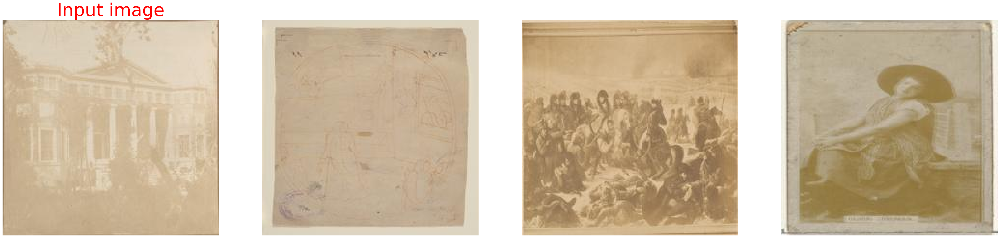

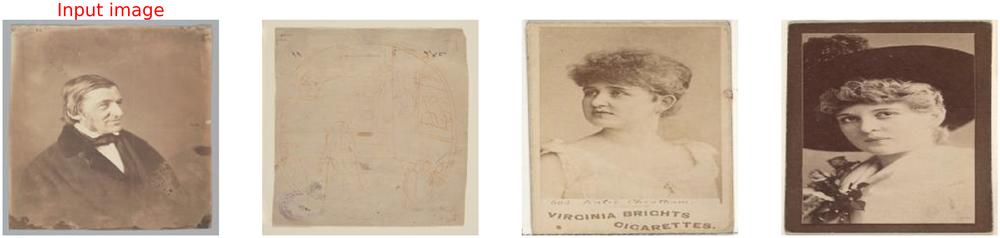

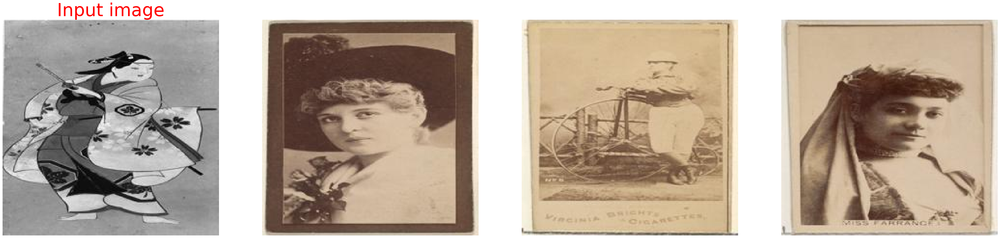

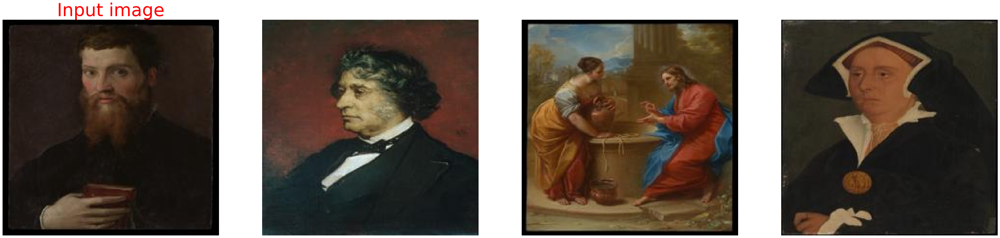

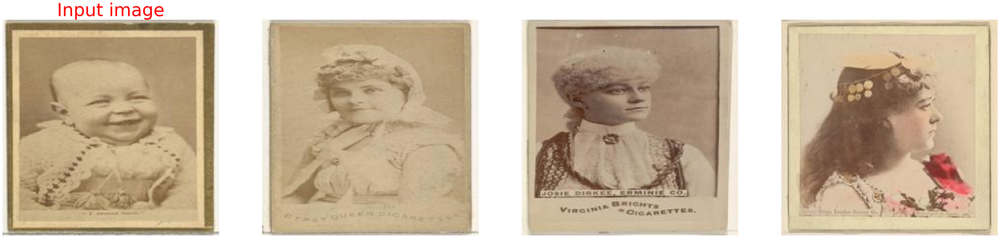

...

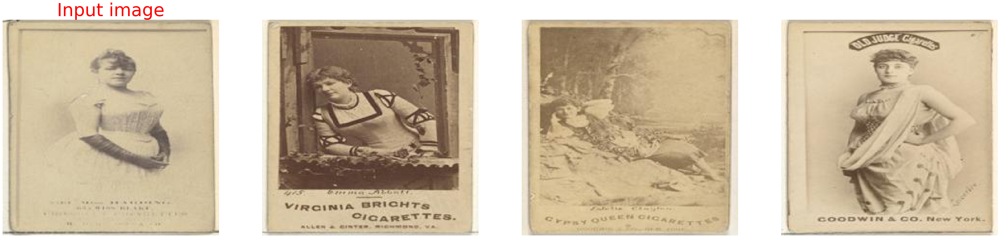

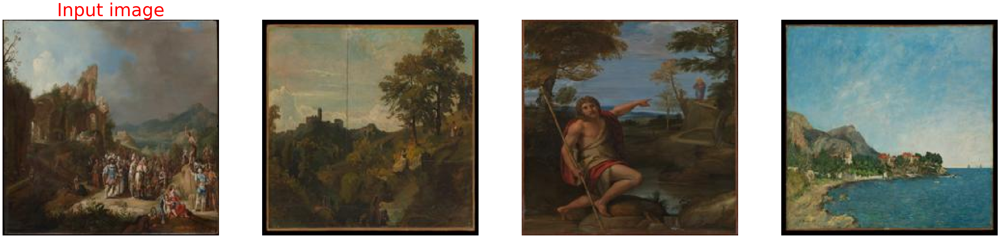

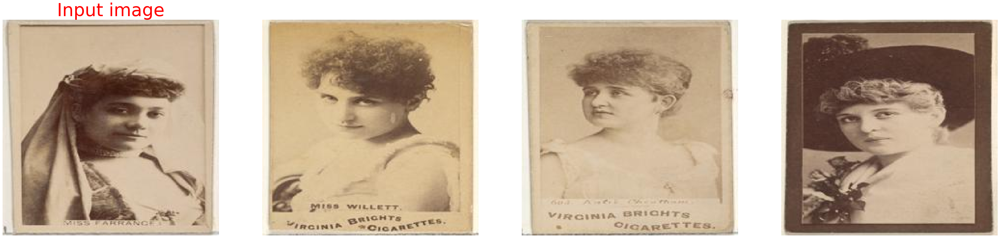

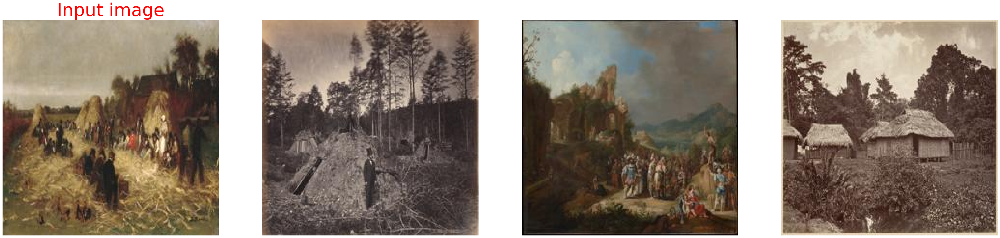

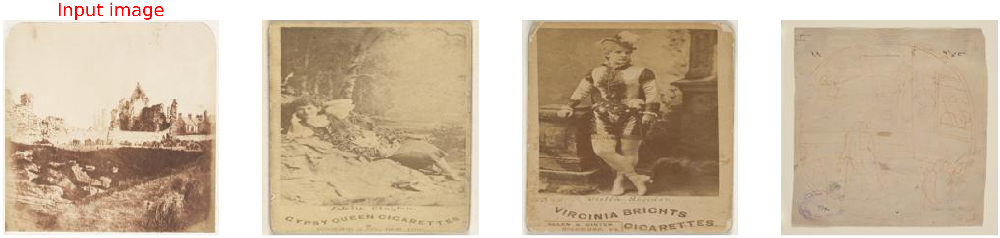

In [116]:
for x in range(20):
    neighbors = find_neighbors(X, X[x])
    print(neighbors)
    plot_neighbors(neighbors)

[20, 69, 91, 55]
[21, 29, 44, 94]
[22, 57, 10, 12]
[23, 56, 75, 61]
[24, 39, 82, 12]
[25, 75, 77, 6]
[26, 95, 74, 31]
[27, 96, 28, 74]
[28, 75, 27, 58]
[29, 57, 10, 82]
[30, 61, 55, 91]
[31, 74, 26, 95]
[32, 91, 59, 54]
[33, 12, 34, 43]
[34, 82, 33, 29]
[35, 28, 86, 92]
[36, 92, 82, 29]
[37, 33, 11, 22]
[38, 57, 29, 92]
[39, 24, 33, 34]


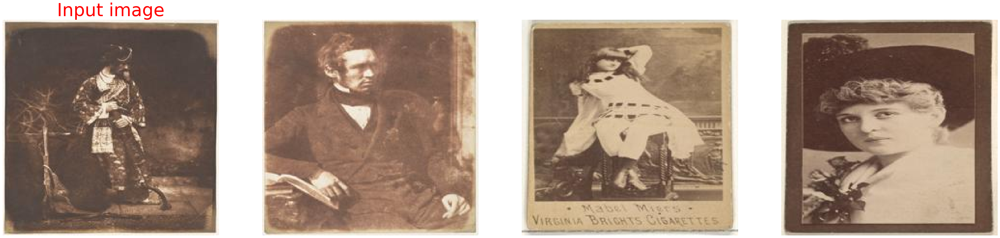

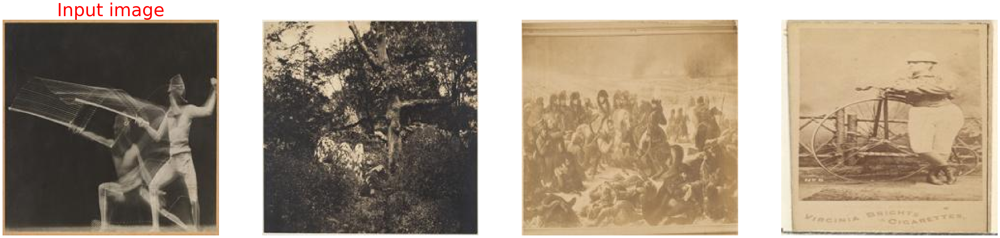

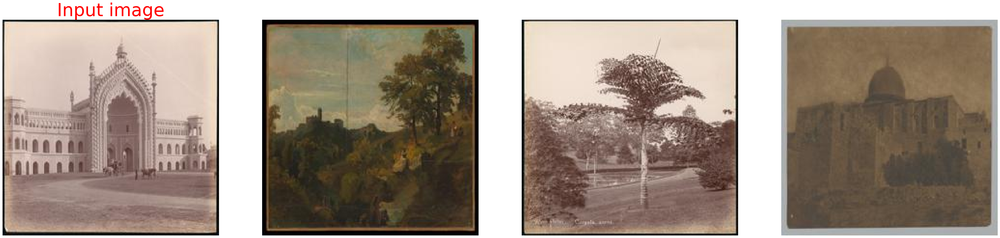

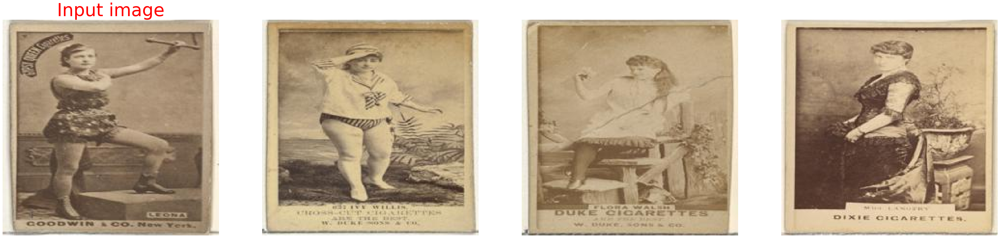

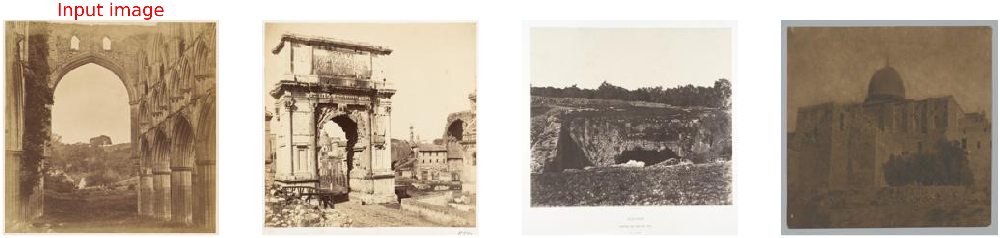

...

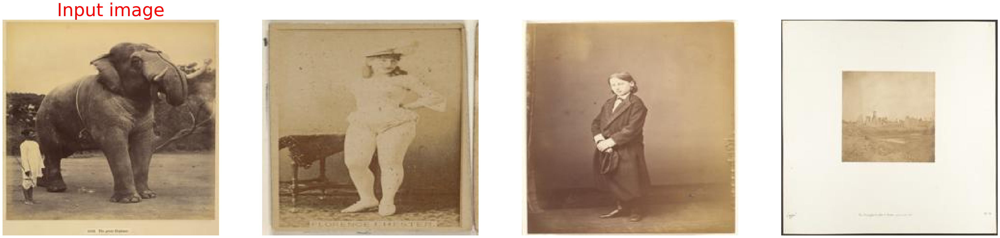

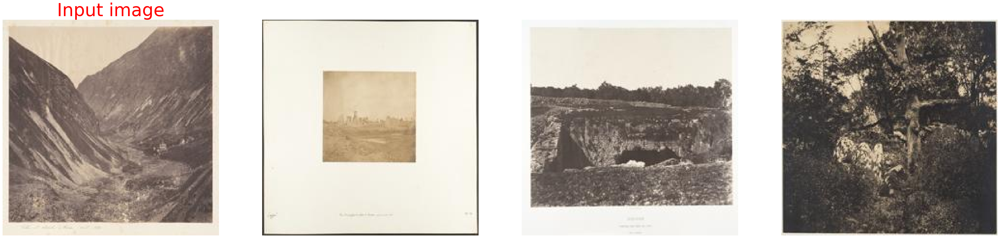

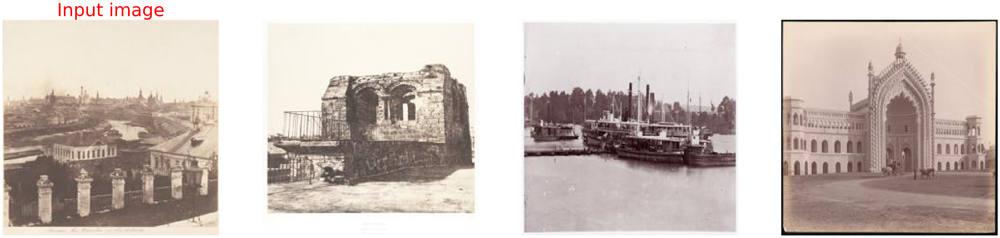

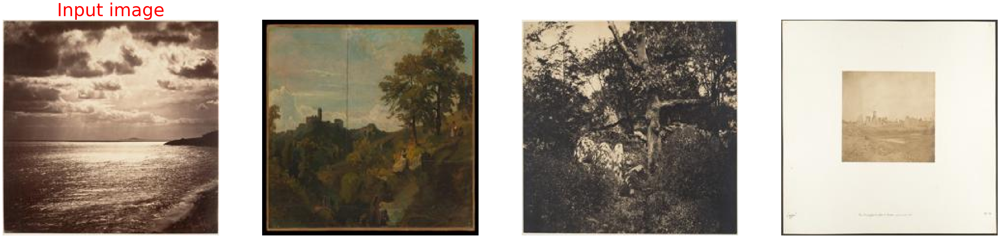

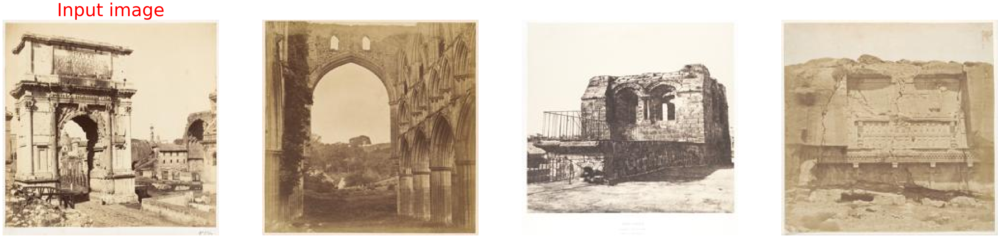

In [120]:
for x in range(20,40):
    neighbors = find_neighbors(X, X[x])
    print(neighbors)
    plot_neighbors(neighbors)